# Introduction

Our notebooks have been initialized thanks to several sources provided around the Home Credit default risk [Kaggle](https://www.kaggle.com/c/home-credit-default-risk) competition: data from Home Credit, Kernels-Notebooks from competitors, Discussions threads involving host and competitors.

While the objective of competitors is to get the best AUC score _Area under the ROC Curve_ by *__any means__*, we'll rather focuse on the ability to provide *__interpretable__* decisions, including the possibility given to customers to explore their case.

# Notebooks & dashboard

There are 4 different notebooks:
* __Current : P7_EDA__: focusing on Exploratory Data Analysis,
* __P7_FE_FS__: focusing on Feature engineering and a first model-agnostic Feature Selection,
* __P7_Model__: focusing on scoring with model evaluation,
* __P7_Interpretation__ : focusing on model interpretation, <br/>
* and a __Dashboard__ python file.


# Data

This diagram shows data relationship :

<img src="https://storage.googleapis.com/kaggle-media/competitions/home-credit/home_credit.png" class="svg" alt="" width="700" height="700">

There are 7 different sources of data:
Current application:
* __application__: details about each `SK_ID_CURR` loan application and applicant + `TARGET` indicating the risk of failure to repay loan on time.
* __test__: where the `TARGET` has not been calculated yet.

External previous credits information:
* __bureau__: details about each `SK_ID_BUREAU` client's previous credits oustide our company, with cardinality 1:n from current application.
* __bureau_balance__: monthly details of each `SK_ID_BUREAU`.
Internal previous credit information:
* __previous_application__: details about each `SK_ID_PREV` client's previous credits applications within our company, with cardinality 1:n from current application.
* __POS_CASH_balance__: monthly details of each `SK_ID_PREV` (credits or cash types).
* __credit_card_balance__: monthly details of each `SK_ID_PREV` (credit cards revolving type).
* __installments_payment__: payment history of each `SK_ID_PREV`.

Moreover, we are provided with the features definitions (in `HomeCredit_columns_description.csv`). 

# Forewords

In this EDA notebook, we observe any valuable information in order to prepare next steps: Feature Engineering & aggregation process. The idea is to build and intermediate __fully understandable__ dataset, i.e. with any of its feature dealing with relevant details that could be discussed by counsellor in front of an applicant.<br/>
This means we'll have to avoid using "black box" features.
This will surely affect the ability to reach the amazing scores of Kaggle competitors, and it implies to spend additionnal time for the EDA and FE.<br/>
Furthermore, we have to consider this task according to the expectations of the study, which consists in performing __model optimization__ and __model interpretation__. <br/>
This will lead to consider as further optional tasks many EDA & FE ideas, in order to use __model__ and its __interpretation__ bring value in that perspective. <br/>

# Imports

In [1]:
# numpy and pandas for data manipulation
import numpy as np
import pandas as pd

In [2]:
# eda booster - turn off flake8 to avoid logs
from dataprep.eda import plot, plot_correlation, plot_missing

In [3]:
# File system manangement
import os
# pickle
import pickle

In [4]:
# matplotlib and seaborn for plotting
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
# custom functions
# visuals
from ipynb.fs.full.functions import plot_bar_gen, kde_plot

In [6]:
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

In [7]:
# paramètres
# to display any columns
pd.options.display.max_columns = 122
sns.set(style="ticks")
sns.set_style('whitegrid')

## Read in Data 

First, we can list all the available data files. There are a total of 8 files: 2 main files for training (with target) & testing (without the target), and 6 other files containing additional information about each loan. <br/> 
We will analyze target according to training files, then we'll analyze applicant's profile and previous application knowledge. Additionnal features will be engineered for 'any_applications', then splitted back to train/test.

In [8]:
# List files available
print(os.listdir("Data/"))

['aggregated.csv', 'any_app.pkl', 'application.pkl', 'application_miss.pkl', 'application_test.csv', 'application_train.csv', 'application_trunc.csv', 'backup_full_aggregated.csv', 'backup_opti_aggregated.csv', 'boruta_ranking.csv', 'boruta_ranking.pkl', 'boruta_support.pkl', 'bureau.csv', 'bureau.pkl', 'bureau_balance.csv', 'credit_card_balance.csv', 'desc.pkl', 'Descriptions.xlsx', 'final.csv', 'full_aggregated.csv', 'HomeCredit_columns_description.csv', 'installments_payments.csv', 'opti_aggregated.csv', 'POS_CASH_balance.csv', 'previous.pkl', 'previous_application.csv', 'sample_submission.csv', 'sel_app.pkl', 'target.pkl', 'tiny.csv', '~$Descriptions.xlsx']


In [9]:
# first level
application = pd.read_csv('Data/application_train.csv')
test = pd.read_csv('Data/application_test.csv')

In [10]:
test.shape

(48744, 121)

In [11]:
# create and store for furhter use a target df
target = application.filter(['SK_ID_CURR', 'TARGET'])
with open("Data/target.pkl", mode="wb") as df0:
    pickle.dump(target, df0)
del target

In [12]:
# create the entire SK_ID_CURR dataset : any_applications
any_applications = application.append(test).reset_index()
# remove previous index
any_applications.drop(columns=['index'], inplace=True)

In [13]:
# nb of applicants & features
print(application.shape)
print(any_applications.shape)

(307511, 122)
(356255, 122)


In [14]:
# second level
bureau = pd.read_csv('Data/bureau.csv')
print(bureau.shape)

(1716428, 17)


In [15]:
# second level
previous = pd.read_csv('Data/previous_application.csv')
print(previous.shape)

(1670214, 37)


In [16]:
# third level
credit_balance = pd.read_csv('Data/POS_CASH_balance.csv')
print(credit_balance.shape)

(10001358, 8)


In [17]:
# third level
card_balance = pd.read_csv('Data/credit_card_balance.csv')
print(card_balance.shape)

(3840312, 23)


In [18]:
# third level
bureau_balance = pd.read_csv('Data/bureau_balance.csv')
print(bureau_balance.shape)

(27299925, 3)


In [19]:
# third level
installments = pd.read_csv('Data/installments_payments.csv')
print(installments.shape)

(13605401, 8)


The training data has 307511 observations (each one a separate loan) and 122 features (variables) including the `TARGET` (the label we want to predict).

In [20]:
print(test.shape)
test.head(3)

(48744, 121)


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.066,0.059,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.059,0.9732,NaN,NaN,NaN,0.1379,0.125,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0


In [21]:
print('Test and Train split (test size in % of total):', 
      round(100 * test.shape[0] / (application.shape[0] + test.shape[0]), 2))

Test and Train split (test size in % of total): 13.68


Split train | test is approx 13.7%

In [22]:
# getting columns descriptions
col_desc = pd.read_csv('Data/HomeCredit_columns_description.csv', encoding= 'unicode_escape')
print('HomeCredit_columns_description: ', col_desc.shape)
col_desc.head()

HomeCredit_columns_description:  (219, 5)


,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,Target variable (1 - client with payment diffi...,NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN


In [23]:
# get rid of columns & remove duplicates (keep first)
desc = col_desc.filter(['Row', 'Description'])

In [24]:
desc.drop_duplicates(keep='first', inplace=True)

In [25]:
desc.head(1)

,Row,Description
0,SK_ID_CURR,ID of loan in our sample


In [26]:
# get the target description
pd.options.display.max_colwidth = len(desc[desc['Row'] == 'TARGET']['Description'])
desc[desc['Row'] == 'TARGET']['Description']

1    Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)
Name: Description, dtype: object

In [27]:
desc.rename(columns={'Row': 'Feature'}, inplace=True)

In [28]:
# save the lean desc - remove if already upgraded
with open("Data/desc.pkl", mode="wb") as df:
    pickle.dump(desc, df)

In [29]:
with open("Data/desc.pkl", mode="rb") as df:
    desc = pickle.load(df)

In [30]:
desc.head(1)

,Feature,Description
0,SK_ID_CURR,ID of loan in our sample


In [31]:
def add_new_feature_desc(feature, description):
    # load target
    with open("Data/desc.pkl", mode="rb") as df:
        desc = pickle.load(df)
    desc.loc[len(desc.index)] = [feature, description]
    print(desc.loc[len(desc.index)])
    # save the lean desc
    with open("Data/desc.pkl", mode="wb") as df:
        pickle.dump(desc, df)

# Exploratory Data Analysis

## Distribution of the Target Column

Let's rely on the rule as defined : client with payment difficulties means he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample. <br/>
Here, {X, Y} are black-box parameters and they could differ according to the contract types or any other parameters. <br/>
Let's assume that those {Xcash, Ycash} & {Xrevolving, Yrevolving} or even {Xtime, Ytime} values have been adjusted for some good reason, so that learning from known client's failures could help predict future failures, and prevent damages by simply refusing to grant the laon, regardless the financial cost of an effective failure or the benefits.

In [32]:
# failure rate
print('Global failure rate: ' + str(
    round(100 * application[application['TARGET'] == 1].shape[0]/application.shape[0], 2)) + ' %')

Global failure rate: 8.07 %


In [33]:
# differentiate failure rates
cols = ['TARGET', 'NAME_CONTRACT_TYPE']
mask_rev = (application['NAME_CONTRACT_TYPE'] == 'Revolving loans')
mask_cash = (application['NAME_CONTRACT_TYPE'] == 'Cash loans')
mask_revfail = (application['TARGET'] == 1) & (application['NAME_CONTRACT_TYPE'] == 'Revolving loans')
mask_cashfail = (application['TARGET'] == 1) & (application['NAME_CONTRACT_TYPE'] == 'Cash loans')
print('Cash loans failure rate: ' + str(
      round(100 * application[cols][mask_cashfail].shape[0] / application[cols][mask_cash].shape[0], 2)) + ' %')
print('Revolving loans failure rate: ' + str(
      round(100 * application[cols][mask_revfail].shape[0] / application[cols][mask_rev].shape[0], 2)) + ' %')

Cash loans failure rate: 8.35 %
Revolving loans failure rate: 5.48 %


In [34]:
# stats for target / contract_type cases
application_count = application.groupby(
    ['NAME_CONTRACT_TYPE', 'TARGET'],
    as_index=False).agg({'SK_ID_CURR': ['count']})
application_count.columns = ['NAME_CONTRACT_TYPE',
                           'TARGET',
                           'count']
application_count['TARGET'] = application_count['TARGET'].replace([0, 1], ['Payed', 'Failed'])
application_count['NAME_CONTRACT_TYPE'] = application_count['NAME_CONTRACT_TYPE'].replace(
    ['Cash loans', 'Revolving loans'],
    ['Cash', 'Revolving'])
application_count['case'] =  application_count['TARGET'] + '_' + application_count['NAME_CONTRACT_TYPE']
application_count

,NAME_CONTRACT_TYPE,TARGET,count,case
0,Cash,Payed,255011,Payed_Cash
1,Cash,Failed,23221,Failed_Cash
2,Revolving,Payed,27675,Payed_Revolving
3,Revolving,Failed,1604,Failed_Revolving


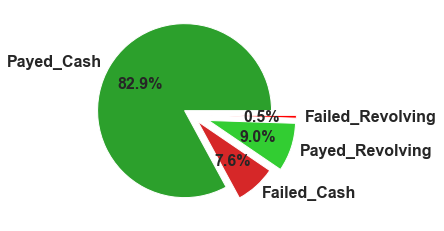

In [35]:
# failure by contract type
explodeList = (0.1, 0.1, 0.2, 0.2)
colorsList = ('tab:green', 'tab:red', 'limegreen', 'red') 
plt.pie(application_count['count'],
        explode=explodeList,
        colors=colorsList,
        labels=application_count['case'],
        autopct='%1.1f%%',
        textprops={'fontsize': 16,
                   'weight': 'bold'}
       )
plt.savefig("pie.png") 

## Contract types & Credits amounts

We check amounts & types from each of the 3 sources.

In [36]:
# case current application : loans amounts
plot(any_applications, "AMT_CREDIT", "NAME_CONTRACT_TYPE")

We'll deal later with outliers: application amount above a given threshold would surely require more attention by the company. <br/>
We can observe that Cash loans application involve higher amounts.

### Internal previous applications

In [37]:
# control SK_ID_PREV as a viable primary key
print(previous.shape[0] - len(previous['SK_ID_PREV'].unique()))

0


In [38]:
# case previous applications, loans amounts
plot(previous, "AMT_CREDIT", 'NAME_CONTRACT_TYPE')

Previous applications let appear the 3rd contract type 'consumer loans' with smaller GOODS_PRICE: we would consider those loans as a subpart of Cash loans.

In [39]:
print(previous[previous['NAME_CONTRACT_TYPE'] == 'XNA'].shape[0])
previous[previous['NAME_CONTRACT_TYPE'] == 'XNA'].sample(3)

346


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
994419,2590821,189402,XNA,NaN,0.0,0.0,NaN,NaN,SATURDAY,13,Y,1,NaN,NaN,NaN,XAP,Canceled,-435,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Country-wide,45,Connectivity,NaN,XNA,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1503590,1708973,344324,XNA,NaN,0.0,0.0,NaN,NaN,TUESDAY,10,Y,1,NaN,NaN,NaN,XAP,Refused,-535,XNA,HC,NaN,Repeater,XNA,XNA,XNA,Country-wide,35,Connectivity,NaN,XNA,NaN,NaN,NaN,NaN,NaN,NaN,NaN
518487,2534813,285972,XNA,NaN,0.0,0.0,NaN,NaN,FRIDAY,15,Y,1,NaN,NaN,NaN,XAP,Canceled,-522,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Country-wide,20,Connectivity,NaN,XNA,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [40]:
previous = previous[previous['NAME_CONTRACT_TYPE'] != 'XNA']

In [41]:
previous['N_CREDIT_TYPE'] = previous['NAME_CONTRACT_TYPE'].apply(lambda x: x if x == 'Revolving loans' else 'Cash loans')

In [42]:
print(previous[previous['FLAG_LAST_APPL_PER_CONTRACT'] != 'Y'].shape[0])
previous[previous['FLAG_LAST_APPL_PER_CONTRACT'] != 'Y'].sample(3)

8475


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE
1084145,2688919,314090,Revolving loans,6750.0,0.0,135000.0,NaN,NaN,THURSDAY,13,N,1,NaN,NaN,NaN,XAP,Refused,-397,XNA,HC,NaN,Repeater,XNA,Cards,x-sell,AP+ (Cash loan),10,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans
115147,2532802,105590,Revolving loans,6750.0,0.0,180000.0,NaN,NaN,TUESDAY,17,N,0,NaN,NaN,NaN,XAP,Refused,-2356,XNA,XNA,NaN,Repeater,XNA,Cards,x-sell,Country-wide,368,Consumer electronics,0.0,XNA,Card Street,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans
415169,2787037,372660,Revolving loans,11250.0,225000.0,225000.0,NaN,225000.0,TUESDAY,16,N,1,NaN,NaN,NaN,XAP,Refused,-298,XNA,HC,Unaccompanied,Repeater,XNA,Cards,x-sell,Credit and cash offices,-1,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans


In [43]:
print(previous[previous['NFLAG_LAST_APPL_IN_DAY'] == 0].shape[0])
previous[previous['NFLAG_LAST_APPL_IN_DAY'] == 0].sample(3)

5900


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE
1668031,1296138,396521,Revolving loans,4500.0,112500.0,112500.0,NaN,112500.0,WEDNESDAY,9,N,0,NaN,NaN,NaN,XAP,Refused,-182,XNA,HC,Family,Repeater,XNA,Cards,x-sell,AP+ (Cash loan),14,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans
852398,2013160,308079,Revolving loans,19125.0,405000.0,405000.0,NaN,405000.0,SUNDAY,13,N,0,NaN,NaN,NaN,XAP,Refused,-33,XNA,HC,Family,Repeater,XNA,Cards,x-sell,Stone,1916,Consumer electronics,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans
880266,1397173,171855,Revolving loans,4500.0,157500.0,157500.0,NaN,157500.0,FRIDAY,12,N,0,NaN,NaN,NaN,XAP,Refused,-97,XNA,HC,Unaccompanied,Repeater,XNA,Cards,x-sell,Credit and cash offices,-1,XNA,0.0,XNA,Card X-Sell,NaN,NaN,NaN,NaN,NaN,NaN,Revolving loans



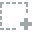
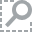
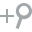
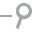
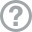
...
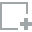
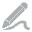
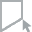
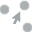
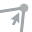

In [44]:
plot(previous, 'NAME_CONTRACT_STATUS')

Although this could have helped to learn from cases where the applicant switched to alternate offers in order to reach an approval, we only have one loan ID available, we decide to keep those non robust previous laon details.

In [45]:
# keep those details even if non robust
# previous = previous[previous['NFLAG_LAST_APPL_IN_DAY'] == 1]
# previous = previous[previous['FLAG_LAST_APPL_PER_CONTRACT'] == 'Y']


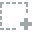
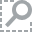
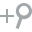
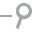
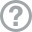
...
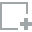
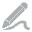
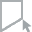
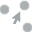
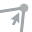

In [46]:
plot(previous, 'NAME_CONTRACT_STATUS')

array([<AxesSubplot:ylabel='NAME_CONTRACT_STATUS'>], dtype=object)

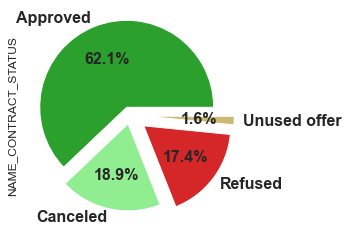

In [47]:
explodeList = (0.1, 0.1, 0.2, 0.2)
colorsList = ('tab:green', 'lightgreen', 'tab:red', 'y') 
pd.DataFrame(previous['NAME_CONTRACT_STATUS'].value_counts()).plot(
    kind='pie',
    subplots=True,
    autopct='%1.1f%%',
    colors=colorsList,
    explode=explodeList,
    legend=False,
    textprops={'fontsize': 16,
               'weight': 'bold'}
)

In [49]:
print(previous[previous['NAME_CONTRACT_STATUS'] == 'Unused offer'].shape[0])
previous[previous['NAME_CONTRACT_STATUS'] == 'Unused offer'].sample(3)

26436


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE
1226175,1218212,165939,Consumer loans,NaN,42610.5,42610.5,0.0,42610.5,WEDNESDAY,9,Y,1,0.0,NaN,NaN,XAP,Unused offer,-692,Cash through the bank,CLIENT,NaN,Repeater,Mobile,XNA,XNA,Country-wide,25,Connectivity,NaN,XNA,POS mobile with interest,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans
1256843,2078712,169585,Consumer loans,NaN,129285.0,129285.0,0.0,129285.0,MONDAY,7,Y,1,0.0,NaN,NaN,XAP,Unused offer,-1165,Cash through the bank,CLIENT,NaN,Repeater,Mobile,XNA,XNA,Country-wide,60,Connectivity,NaN,XNA,POS mobile with interest,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans
1140958,2455886,279204,Consumer loans,14129.64,124402.5,124402.5,0.0,124402.5,THURSDAY,16,Y,1,0.0,NaN,NaN,XAP,Unused offer,-102,Cash through the bank,CLIENT,NaN,Repeater,Mobile,POS,XNA,Country-wide,39,Connectivity,10.0,low_normal,POS mobile without interest,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans


In [50]:
print(previous[previous['NAME_CONTRACT_STATUS'] == 'Canceled'].shape[0])
previous[previous['NAME_CONTRACT_STATUS'] == 'Canceled'].sample(3)

316004


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE
135806,2799646,278143,Cash loans,NaN,0.0,0.0,NaN,NaN,THURSDAY,16,Y,1,NaN,NaN,NaN,XNA,Canceled,-136,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans
925940,1981654,239825,Cash loans,NaN,0.0,0.0,NaN,NaN,FRIDAY,13,Y,1,NaN,NaN,NaN,XNA,Canceled,-188,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans
1367552,1759161,420123,Cash loans,NaN,0.0,0.0,NaN,NaN,WEDNESDAY,9,Y,1,NaN,NaN,NaN,XNA,Canceled,-248,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans


In [51]:
# keep those details even if non robust
# previous = previous[previous['NAME_CONTRACT_STATUS'] != 'Canceled']

In [52]:
previous['N_FLAG_REJECTED'] = previous['NAME_CONTRACT_STATUS'].apply(lambda x: 1 if x == 'Refused' else 0)


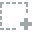
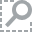
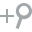
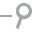
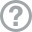
...
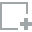
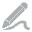
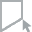
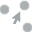
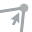

In [53]:
plot(previous, 'N_FLAG_REJECTED')


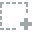
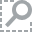
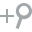
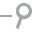
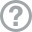
...
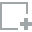
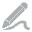
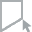
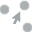
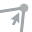

In [54]:
plot(previous, 'CODE_REJECT_REASON')

In [55]:
previous['N_CODE_REJECT_REASON'] = 'REJECTED_' + previous['CODE_REJECT_REASON'].astype(str)

In [56]:
previous['N_CONTRACT_STATUS'] = previous['N_CODE_REJECT_REASON'].apply(lambda x: x if x != 'REJECTED_XAP' else 'APPROVED')


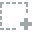
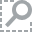
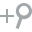
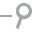
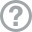
...
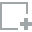
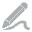
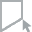
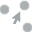
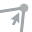

In [57]:
plot(previous, 'N_CONTRACT_STATUS')

In [58]:
sample = previous[previous['DAYS_FIRST_DUE'].isna()]
print(sample[sample['N_CONTRACT_STATUS'] == 'APPROVED'].shape[0])
sample[sample['N_CONTRACT_STATUS'] == 'APPROVED'].sample(3)

355637


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE,N_FLAG_REJECTED,N_CODE_REJECT_REASON,N_CONTRACT_STATUS
154127,1243482,283306,Cash loans,NaN,0.0,0.0,NaN,NaN,MONDAY,11,Y,1,NaN,NaN,NaN,XNA,Canceled,-28,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans,0,REJECTED_XAP,APPROVED
875427,1352779,280982,Cash loans,NaN,0.0,0.0,NaN,NaN,TUESDAY,14,Y,1,NaN,NaN,NaN,XNA,Canceled,-350,XNA,XAP,NaN,Refreshed,XNA,XNA,XNA,Credit and cash offices,-1,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans,0,REJECTED_XAP,APPROVED
1549670,1426423,301535,Cash loans,NaN,0.0,0.0,NaN,NaN,WEDNESDAY,11,Y,1,NaN,NaN,NaN,XNA,Canceled,-246,XNA,XAP,NaN,Repeater,XNA,XNA,XNA,Credit and cash offices,-1,XNA,NaN,XNA,Cash,NaN,NaN,NaN,NaN,NaN,NaN,Cash loans,0,REJECTED_XAP,APPROVED


In [59]:
previous.loc[(previous['NAME_CONTRACT_STATUS'] == 'Approved') & (previous['DAYS_FIRST_DUE'].isna()), 'N_CONTRACT_STATUS'] = 'NOTUSED'


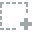
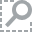
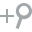
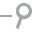
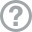
...
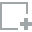
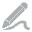
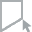
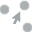
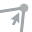

In [60]:
plot(previous, 'N_CONTRACT_STATUS')

In [61]:
previous_status_count = previous.groupby(['SK_ID_CURR', 'N_CONTRACT_STATUS']).size().unstack(fill_value=0)

In [62]:
previous_status_count.head(3)

N_CONTRACT_STATUS,APPROVED,NOTUSED,REJECTED_CLIENT,REJECTED_HC,REJECTED_LIMIT,REJECTED_SCO,REJECTED_SCOFR,REJECTED_SYSTEM,REJECTED_VERIF,REJECTED_XNA
SK_ID_CURR,,,,,,,,,,
100001,1,0,0,0,0,0,0,0,0,0
100002,1,0,0,0,0,0,0,0,0,0
100003,3,0,0,0,0,0,0,0,0,0


In [63]:
previous_status_count.columns = ['N_CNT_PREV_' + str(col) for col in previous_status_count.columns]

In [64]:
any_applications = any_applications.merge(previous_status_count, on='SK_ID_CURR', how='left')

In [65]:
for i in previous_status_count.columns:
    any_applications[i] = any_applications[i].fillna(0)

In [66]:
any_applications.head(1)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,...,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_APPROVED,N_CNT_PREV_NOTUSED,N_CNT_PREV_REJECTED_CLIENT,N_CNT_PREV_REJECTED_HC,N_CNT_PREV_REJECTED_LIMIT,N_CNT_PREV_REJECTED_SCO,N_CNT_PREV_REJECTED_SCOFR,N_CNT_PREV_REJECTED_SYSTEM,N_CNT_PREV_REJECTED_VERIF,N_CNT_PREV_REJECTED_XNA
0,100002,1.0,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.0,0.069,0.0833,0.125,0.0369,0.0202,0.019,0.0,0.0,0.0252,0.0383,0.9722,...,0.0,0.025,0.0369,0.9722,0.6243,0.0144,0.0,0.069,0.0833,0.125,0.0375,0.0205,0.0193,0.0,0.0,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [67]:
# keep only rejected previous applications
prev_rejected = previous[previous['N_FLAG_REJECTED'] == 1]

In [68]:
# get most recent rejection
previous_last_loan_rejection = prev_rejected.groupby(
    ['SK_ID_CURR', 'N_FLAG_REJECTED'],
    as_index=False).agg(
    {'DAYS_DECISION': ['max']})
previous_last_loan_rejection.columns = [
    'SK_ID_CURR',
    'N_FLAG_REJECTED',
    'N_LAST_REJECTION_RECENCY']
previous_last_loan_rejection = previous_last_loan_rejection.sort_values(
    by='N_LAST_REJECTION_RECENCY',
    ascending=False)
#  keep last rejection only
previous_last_loan_rejection = previous_last_loan_rejection.drop_duplicates(
    subset='SK_ID_CURR',
    keep='first')
# compute the last rejection recency index
previous_last_loan_rejection['N_ADJ_REJECT_RECENCY_INDEX'] = (
    1 - (previous_last_loan_rejection['N_LAST_REJECTION_RECENCY'] / - 2922)) * previous_last_loan_rejection['N_FLAG_REJECTED']

In [69]:
previous_last_loan_rejection.head(3)

,SK_ID_CURR,N_FLAG_REJECTED,N_LAST_REJECTION_RECENCY,N_ADJ_REJECT_RECENCY_INDEX
53159,260758,1,-2,0.999316
71745,316314,1,-2,0.999316
105234,417900,1,-2,0.999316


In [70]:
previous_last_loan_rejection.drop(columns=['N_LAST_REJECTION_RECENCY'], inplace=True)

In [71]:
any_applications = any_applications.merge(previous_last_loan_rejection, on='SK_ID_CURR', how='left')

In [72]:
any_applications.head(1)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,...,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_APPROVED,N_CNT_PREV_NOTUSED,N_CNT_PREV_REJECTED_CLIENT,N_CNT_PREV_REJECTED_HC,N_CNT_PREV_REJECTED_LIMIT,N_CNT_PREV_REJECTED_SCO,N_CNT_PREV_REJECTED_SCOFR,N_CNT_PREV_REJECTED_SYSTEM,N_CNT_PREV_REJECTED_VERIF,N_CNT_PREV_REJECTED_XNA,N_FLAG_REJECTED,N_ADJ_REJECT_RECENCY_INDEX
0,100002,1.0,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.0,0.069,0.0833,0.125,0.0369,0.0202,0.019,0.0,0.0,0.0252,0.0383,0.9722,...,0.0369,0.9722,0.6243,0.0144,0.0,0.069,0.0833,0.125,0.0375,0.0205,0.0193,0.0,0.0,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN


In [73]:
any_applications['N_ADJ_REJECT_RECENCY_INDEX'] = any_applications['N_ADJ_REJECT_RECENCY_INDEX'].fillna(0)
any_applications['N_FLAG_REJECTED'] = any_applications['N_FLAG_REJECTED'].fillna(0)

In [74]:
add_new_feature_desc('N_FLAG_REJECTED', 'Flag is 1 if most recent previous contract status was rejected')
add_new_feature_desc('N_ADJ_REJECT_RECENCY_INDEX', '0 if never rejected up to 1 if recently rejected')

Feature        N_FLAG_REJECTED                                               
Description    Flag is 1 if most recent previous contract status was rejected
Name: 213, dtype: object
Feature        N_ADJ_REJECT_RECENCY_INDEX                      
Description    0 if never rejected up to 1 if recently rejected
Name: 213, dtype: object


In [75]:
# get most recent internal laon by decision
previous_last_loan_decision = previous.groupby(
    ['SK_ID_CURR', 'N_CONTRACT_STATUS'],
    as_index=False).agg(
    {'DAYS_DECISION': ['max']})
previous_last_loan_decision.columns = [
    'SK_ID_CURR',
    'N_CONTRACT_STATUS',
    'N_PREV_LAST_APPLICATION']
previous_last_loan_decision = previous_last_loan_decision.sort_values(
    by='N_PREV_LAST_APPLICATION',
    ascending=False)

In [76]:
#  keep last decision only
previous_last_loan_decision = previous_last_loan_decision.drop_duplicates(
    subset='SK_ID_CURR',
    keep='first')
# rename the new feature
previous_last_loan_decision = previous_last_loan_decision.rename(columns={'N_CONTRACT_STATUS': 'N_PREV_LAST_DECISION'})

In [77]:
previous_last_loan_decision.head(3)

,SK_ID_CURR,N_PREV_LAST_DECISION,N_PREV_LAST_APPLICATION
413824,369722,APPROVED,-1
531876,446450,APPROVED,-1
345165,324935,REJECTED_HC,-2


In [78]:
previous_last_loan_decision[previous_last_loan_decision['SK_ID_CURR'] == 456255]

,SK_ID_CURR,N_PREV_LAST_DECISION,N_PREV_LAST_APPLICATION
546928,456255,REJECTED_HC,-171


In [79]:
any_applications = any_applications.merge(previous_last_loan_decision, on='SK_ID_CURR', how='left')

In [80]:
any_applications['N_PREV_LAST_DECISION'].unique()

array(['APPROVED', 'REJECTED_LIMIT', nan, 'NOTUSED', 'REJECTED_HC',
       'REJECTED_SCOFR', 'REJECTED_SCO', 'REJECTED_CLIENT',
       'REJECTED_XNA', 'REJECTED_VERIF', 'REJECTED_SYSTEM'], dtype=object)

In [81]:
any_applications['N_PREV_LAST_DECISION'] = any_applications['N_PREV_LAST_DECISION'].fillna('NONE')
any_applications['N_PREV_LAST_APPLICATION'] = any_applications['N_PREV_LAST_APPLICATION'].fillna(-2922)


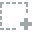
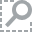
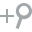
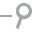
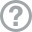
...
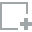
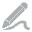
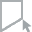
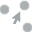
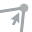

In [82]:
# get previous internal loans count
previous_loan_counts = previous.groupby(
    'SK_ID_CURR',
    as_index=False)['SK_ID_PREV'].count().rename(columns={'SK_ID_PREV': 'N_CNT_PREV_LOANS'})
any_applications = any_applications.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
plot(any_applications, 'N_CNT_PREV_LOANS')

In [83]:
add_new_feature_desc('N_CNT_PREV_LOANS', 'Previous internal loans counts')

Feature        N_CNT_PREV_LOANS              
Description    Previous internal loans counts
Name: 213, dtype: object


5 % of applicants have no previous internal loan info. Average of known previous applications is 4 and goes up to 74 previous applications for one single applicant.

In [84]:
any_applications.head(2)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,...,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_APPROVED,N_CNT_PREV_NOTUSED,N_CNT_PREV_REJECTED_CLIENT,N_CNT_PREV_REJECTED_HC,N_CNT_PREV_REJECTED_LIMIT,N_CNT_PREV_REJECTED_SCO,N_CNT_PREV_REJECTED_SCOFR,N_CNT_PREV_REJECTED_SYSTEM,N_CNT_PREV_REJECTED_VERIF,N_CNT_PREV_REJECTED_XNA,N_FLAG_REJECTED,N_ADJ_REJECT_RECENCY_INDEX,N_PREV_LAST_DECISION,N_PREV_LAST_APPLICATION,N_CNT_PREV_LOANS
0,100002,1.0,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,...,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,APPROVED,-606.0,1.0
1,100003,0.0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,...,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.01,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,APPROVED,-746.0,3.0


In [85]:
any_applications['N_REJECT_RATE'] = 1 - (
    any_applications['N_CNT_PREV_APPROVED'] + any_applications['N_CNT_PREV_NOTUSED']) / any_applications['N_CNT_PREV_LOANS']

In [86]:
any_applications['N_REJECT_RATE'] = any_applications['N_REJECT_RATE'].fillna(0)

In [87]:
add_new_feature_desc('N_REJECT_RATE', '0 if never rejected up to 1 is always rejected')

Feature        N_REJECT_RATE                                 
Description    0 if never rejected up to 1 is always rejected
Name: 213, dtype: object



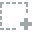
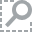
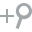
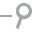
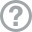
...
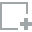
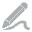
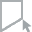
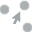
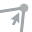

In [88]:
plot(any_applications['N_REJECT_RATE'])

### External loans


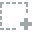
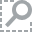
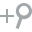
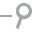
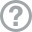
...
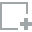
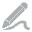
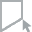
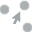
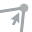

In [89]:
# case of external loans from "Credit Bureau"
plot(bureau, 'CREDIT_TYPE')


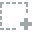
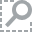
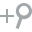
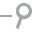
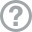
...
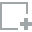
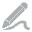
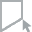
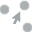
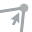

In [151]:
# case of external loans from "Credit Bureau"
plot(bureau, 'DAYS_CREDIT')

The largest value (Consumer credit) is over 3 times larger than the second largest value (Credit card)

Bureau applications let appear many other contract types, mainly due to the detailed purpose & context of the application. We should merge first to dig deeper, then eventually grouping relevant new types into application subset : basically we would consider only Credit Card as Revolving credits, and others as Cash + Consumer credits.

In [90]:
# clip by Mortgage upper whisker for line chart view
plot(bureau[bureau['AMT_CREDIT_SUM'] < 2500000], "AMT_CREDIT_SUM", 'CREDIT_TYPE')

In [91]:
bureau['CREDIT_TYPE'] = bureau['CREDIT_TYPE'].apply(lambda x: x if x == 'Credit card' else 'Cash loans')


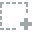
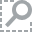
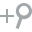
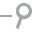
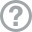
...
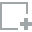
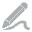
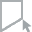
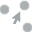
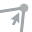

In [92]:
# get previous external loans count
bureau_loan_counts = bureau.groupby(
    'SK_ID_CURR',
    as_index=False)['SK_ID_BUREAU'].count().rename(columns={'SK_ID_BUREAU': 'N_CNT_BUR_LOANS'})
any_applications = any_applications.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')
plot(any_applications, 'N_CNT_BUR_LOANS')

In [93]:
add_new_feature_desc('N_CNT_BUR_LOANS', ' Previous external loans count')

Feature        N_CNT_BUR_LOANS               
Description     Previous external loans count
Name: 213, dtype: object


In [94]:
# get most recent external laon - approved only
bureau_last_loan_application = bureau.groupby(
    ['SK_ID_CURR'],
    as_index=False).agg(
    {'DAYS_CREDIT': ['max']})
bureau_last_loan_application.columns = [
    'SK_ID_CURR',
    'N_BUR_LAST_APPLICATION']
bureau_last_loan_application = bureau_last_loan_application.sort_values(
    by='N_BUR_LAST_APPLICATION',
    ascending=False)

In [95]:
bureau_last_loan_application

,SK_ID_CURR,N_BUR_LAST_APPLICATION
229613,367465,0
71154,182735,0
148948,273313,0
248926,390003,0
225873,363106,0
...,...,...
217097,352888,-2922
45398,152867,-2922
64514,175053,-2922
251327,392779,-2922


In [96]:
any_applications = any_applications.merge(bureau_last_loan_application, on='SK_ID_CURR', how='left')

In [97]:
any_applications['N_BUR_LAST_APPLICATION'] = any_applications['N_BUR_LAST_APPLICATION'].fillna(-2922)

In [98]:
# get the total count of loans
any_applications['N_CNT_BUR_LOANS'] = any_applications['N_CNT_BUR_LOANS'].fillna(0)
any_applications['N_CNT_PREV_LOANS'] = any_applications['N_CNT_PREV_LOANS'].fillna(0)
any_applications['N_CNT_TOT_LOANS'] = any_applications['N_CNT_BUR_LOANS'] + any_applications['N_CNT_PREV_LOANS']

In [99]:
add_new_feature_desc('N_CNT_TOT_LOANS', 'Previous total loans counts')

Feature        N_CNT_TOT_LOANS            
Description    Previous total loans counts
Name: 213, dtype: object



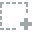
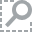
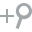
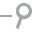
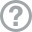
...
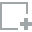
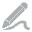
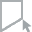
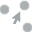
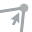

In [100]:
plot(any_applications['N_CNT_TOT_LOANS'])

In [101]:
print('Clients with previous external loans: ' + str(
    round(100 - 100 * any_applications[any_applications['N_CNT_BUR_LOANS'] == 0].shape[0]/any_applications.shape[0], 2)) + ' %')
print('Clients with previous internal loans: ' + str(
    round(100 - 100 * any_applications[any_applications['N_CNT_PREV_LOANS'] == 0].shape[0]/any_applications.shape[0], 2)) + ' %')
print('Clients with no previous loans: ' + str(
    round(100 * any_applications[any_applications['N_CNT_TOT_LOANS'] == 0].shape[0]/any_applications.shape[0], 2)) + ' %')

Clients with previous external loans: 85.84 %
Clients with previous internal loans: 95.12 %
Clients with no previous loans: 0.75 %


In [102]:
with_both = any_applications[(any_applications['N_CNT_PREV_LOANS'] > 0) & (any_applications['N_CNT_BUR_LOANS'] > 0)].shape[0]
print('Clients with both loans knowledge: ' + str(
    round(100 * with_both/any_applications.shape[0], 2)) + ' %')

Clients with both loans knowledge: 81.71 %


In [103]:
test = test.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
test = test.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')
test['N_CNT_BUR_LOANS'] = test['N_CNT_BUR_LOANS'].fillna(0)
test['N_CNT_PREV_LOANS'] = test['N_CNT_PREV_LOANS'].fillna(0)
test['N_CNT_TOT_LOANS'] = test['N_CNT_BUR_LOANS'] + test['N_CNT_PREV_LOANS']

In [104]:
application = application.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
application = application.merge(bureau_loan_counts, on='SK_ID_CURR', how='left')
application['N_CNT_BUR_LOANS'] = application['N_CNT_BUR_LOANS'].fillna(0)
application['N_CNT_PREV_LOANS'] = application['N_CNT_PREV_LOANS'].fillna(0)
application['N_CNT_TOT_LOANS'] = application['N_CNT_BUR_LOANS'] + application['N_CNT_PREV_LOANS']

In [105]:
print(test[test['N_CNT_TOT_LOANS'] == 0].shape[0])
print(application[application['N_CNT_TOT_LOANS'] == 0].shape[0])

208
2470


In [106]:
print('rate of unknown applicants, test set: ' + str(
      round(100 * test[test['N_CNT_TOT_LOANS'] == 0].shape[0] / test.shape[0], 2)) + ' %')

rate of unknown applicants, test set: 0.43 %


In [107]:
print('rate of unknown applicants, train set: ' + str(
      round(100 * application[application['N_CNT_TOT_LOANS'] == 0].shape[0] / application.shape[0], 2)) + ' %')

rate of unknown applicants, train set: 0.8 %


## Monthly balance

We dig one level deeper with x_balance datasets, containing monthly balances of any credit.

In [108]:
sk_prev_ids = previous['SK_ID_PREV'].unique()
print('number of previous applications: ' + str(len(sk_prev_ids)))

number of previous applications: 1669868


In [109]:
# how many previous loans have their installments details & of previous
ins_sk_prev_ids = installments['SK_ID_PREV'].unique()
print('number of previous applications with installments details: ' + str(len(ins_sk_prev_ids)))
print('rate of previous applications with installments details: ')
print(round(len(set(ins_sk_prev_ids).intersection(set(sk_prev_ids)))/len(sk_prev_ids), 2))
print('excess rate of installments details - without previous applications to refer to: ')
print(round((len(ins_sk_prev_ids) - len(set(ins_sk_prev_ids).intersection(set(sk_prev_ids))))/len(ins_sk_prev_ids), 2))

number of previous applications with installments details: 997752
rate of previous applications with installments details: 
0.57
excess rate of installments details - without previous applications to refer to: 
0.04


29% of previous applications have no installements (for many reasons such as revolving not yet active, rejected loans, etc.) and 4% of installements details are not linked to a previous application.

In [110]:
# how many previous loans have their credit balance details & of previous
credit_sk_prev_ids = credit_balance['SK_ID_PREV'].unique()
print('number of previous applications with credit balance details: ' + str(len(credit_sk_prev_ids)))
print('rate of previous applications with credit balance details: ')
print(round(len(set(credit_sk_prev_ids).intersection(set(sk_prev_ids)))/len(sk_prev_ids), 2))
print('excess rate of credit balance details - without previous applications to refer to: ')
print(round((len(credit_sk_prev_ids) - len(set(credit_sk_prev_ids).intersection(set(sk_prev_ids))))/len(credit_sk_prev_ids), 2))

number of previous applications with credit balance details: 936325
rate of previous applications with credit balance details: 
0.54
excess rate of credit balance details - without previous applications to refer to: 
0.04


33% of previous applications have no credits balance (for many reasons such as alternate type of contract, etc.) and 4% of credit balance are not linked to a previous application.

In [111]:
# how many previous loans have their card balance details & of previous
card_sk_prev_ids = card_balance['SK_ID_PREV'].unique()
print('number of previous applications with card balance details: ' + str(len(card_sk_prev_ids)))
print('rate of previous applications with card balance details: ')
print(round(len(set(card_sk_prev_ids).intersection(set(sk_prev_ids)))/len(sk_prev_ids), 2))
print('excess rate of card balance details - without previous applications to refer to: ')
print(round((len(card_sk_prev_ids) - len(set(card_sk_prev_ids).intersection(set(sk_prev_ids))))/len(card_sk_prev_ids), 2))

number of previous applications with card balance details: 104307
rate of previous applications with card balance details: 
0.06
excess rate of card balance details - without previous applications to refer to: 
0.11


93% of previous applications have no card balance (for many reasons such as alternate type of contract), and 11% of card balance are not linked to a previous application.

! there are numerous installments, credit or card balance details of previous credit not in the df previous, and there are numerous previous applications without balance details.

In [112]:
# check if no common sk_id between credit and card balance
common_sk_prev_ids = list(set(credit_sk_prev_ids).intersection(set(card_sk_prev_ids)))
len(common_sk_prev_ids)

0

In [113]:
# how many previous loans doesnt't have card nor credit details
a = len(set(card_sk_prev_ids).intersection(set(sk_prev_ids)))
b = len(set(credit_sk_prev_ids).intersection(set(sk_prev_ids)))
print('rate of previous application with no balance details  : ' + str(
    round(100 * (len(sk_prev_ids) - (a + b))/len(sk_prev_ids), 2)) + ' %')

rate of previous application with no balance details  : 40.6 %


In [114]:
# how many credits balances have installments details, of overall
ins_cred_sk_prev_ids = list(set(ins_sk_prev_ids).intersection(set(credit_sk_prev_ids)))
print(len(ins_cred_sk_prev_ids))
print(len(credit_sk_prev_ids) - len(ins_cred_sk_prev_ids))

924949
11376


In [115]:
# how many card balances have installments details, of overall
ins_card_sk_prev_ids = list(set(ins_sk_prev_ids).intersection(set(card_sk_prev_ids)))
print(len(ins_card_sk_prev_ids))
print(len(card_sk_prev_ids) - len(ins_card_sk_prev_ids))

72466
31841


There is an inconsistency between the previous loans level of detail and the 3 sub-level sources of detail : therefore, to keep any valuable information from any of the 4 files, we'll have to find a way to skip the merge with previous loans and rather gather on SK_ID_CURR. 


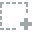
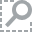
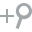
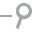
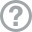
...
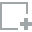
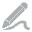
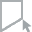
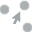
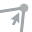

In [116]:
# monthly balance of the Bureau Credits
plot(bureau_balance['STATUS'], progress=False)

Basically we get here to the complete story of external loans (well, considering X - unknow info for 21,28% of months balance) : <br/>
- C status measures the credit closing AGE in months (DAYS_ENDDATE_FACT in bureau), and any others gives the TERM,
- STATUS from 1-30 days (1) to over 120 days (5) provide the knowledge of clients failure and how deep considering the value of STATUS,
- Failure in early installments could be somehow accessible : the minimal month number where occurs a failure, i.e. with STATUS in [1, 5].


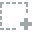
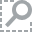
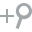
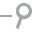
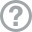
...
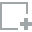
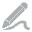
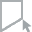
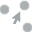
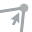

In [117]:
# same with credit balance
plot(credit_balance['NAME_CONTRACT_STATUS'], progress=False)

Opposite to Bureau credits, those contracts are mainly in an Active STATUS (not 'Completed' : closed), 'previous' will provide the right value.


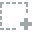
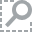
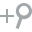
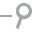
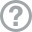
...
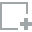
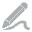
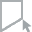
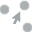
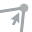

In [118]:
plot(credit_balance[credit_balance['CNT_INSTALMENT_FUTURE'] == 0], 'NAME_CONTRACT_STATUS')

In [119]:
focus_credit = credit_balance[credit_balance['CNT_INSTALMENT_FUTURE'] == 0]
focus_credit = focus_credit[focus_credit['NAME_CONTRACT_STATUS'] == 'Active']

In [120]:
focus_credit.sample(3)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
9536755,1288342,289889,-69,10.0,0.0,Active,0,0
8043154,2725230,433457,-3,18.0,0.0,Active,0,0
3625212,1029381,284568,-83,4.0,0.0,Active,82,0


We got here the case of contracts still Active while there is no future installment : here closed by full payment before term. Let's see how 'previous' application table deal with it.

Contracts could remain in Active STATUS while actualy Completed by anticipation.

In [121]:
# Credit and Card balance
print('failure ratio : ' + str(
    credit_balance[credit_balance['SK_DPD_DEF'] > 0].shape[0] / credit_balance.shape[0]))
credit_balance[credit_balance['SK_DPD_DEF'] > 0].sample(3)

failure ratio : 0.011395352511128989


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
9877672,1182518,433233,-67,24.0,2.0,Active,4,4
6604866,1349926,353458,-23,24.0,13.0,Active,16,16
4260312,1373231,329965,-53,10.0,6.0,Active,2,2


SK_DPD & SK_DPD_DEF contains over 1,1% of monthly failure - with DPD in days and a "tolerance" is applied to build SK_DPD_DEF, in case of small amounts.


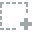
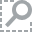
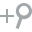
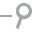
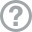
...
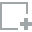
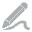
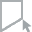
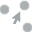
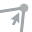

In [122]:
# same with card balance
plot(card_balance, 'NAME_CONTRACT_STATUS')

Again we observe an abnormal Active STATUS.

We won't ge deeper in that path, because we would rather get a similar info from both types of credits, and it represents too much additionnal effort to master this special credit card behavior.

# Client's profile versus Target

We study the native features and their depency to target.

In [123]:
application.head(1)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,...,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_LOANS,N_CNT_BUR_LOANS,N_CNT_TOT_LOANS
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.0,0.069,0.0833,0.125,0.0369,0.0202,0.019,0.0,0.0,0.0252,0.0383,0.9722,...,0.069,0.0833,0.125,0.0377,0.022,0.0198,0.0,0.0,0.025,0.0369,0.9722,0.6243,0.0144,0.0,0.069,0.0833,0.125,0.0375,0.0205,0.0193,0.0,0.0,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,8.0,9.0



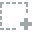
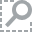
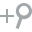
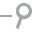
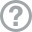
...
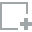
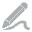
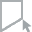
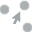
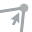

In [124]:
plot_missing(application)

In [125]:
any_applications = any_applications[any_applications['CODE_GENDER'] != 'XNA']
any_applications['YEARS_BIRTH'] = - any_applications['DAYS_BIRTH'] / 365
any_applications['OCCUPATION_TYPE'] = any_applications['OCCUPATION_TYPE'].fillna(any_applications['NAME_INCOME_TYPE'])
application = application[application['CODE_GENDER'] != 'XNA']
application['YEARS_BIRTH'] = - application['DAYS_BIRTH'] / 365
application['OCCUPATION_TYPE'] = application['OCCUPATION_TYPE'].fillna(application['NAME_INCOME_TYPE'])

In [126]:
# NaN values for DAYS_EMPLOYED: 365.243 -> nan
application['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
# Some simple new features (percentages)
application['N_DAYS_EMPLOYED_RATIO'] = application['DAYS_EMPLOYED'] / application['DAYS_BIRTH']
application['N_CREDIT_INCOME_RATIO'] = application['AMT_CREDIT'] / application['AMT_INCOME_TOTAL']
application['N_INCOME_PER_PERSON'] = application['AMT_INCOME_TOTAL'] / application['CNT_FAM_MEMBERS']
application['N_ANNUITY_INCOME_RATIO'] = application['AMT_ANNUITY'] / application['AMT_INCOME_TOTAL']
application['N_CREDIT_TERM'] = application['AMT_ANNUITY'] / application['AMT_CREDIT']
application.drop(columns=['DAYS_BIRTH'], inplace=True)

In [127]:
add_new_feature_desc('YEARS_BIRTH', 'Age of client at application')
add_new_feature_desc('N_DAYS_EMPLOYED_RATIO', 'Ratio Days employed / Age')
add_new_feature_desc('N_CREDIT_INCOME_RATIO', 'Ratio Credit / Income')
add_new_feature_desc('N_INCOME_PER_PERSON', 'Ratio Income / Family members count')
add_new_feature_desc('N_ANNUITY_INCOME_RATIO', 'Ratio Annuity / Income')
add_new_feature_desc('N_CREDIT_TERM', 'Evaluation of Credit Term with Ratio Annuity / Credit')

Feature        YEARS_BIRTH                 
Description    Age of client at application
Name: 213, dtype: object
Feature        N_DAYS_EMPLOYED_RATIO    
Description    Ratio Days employed / Age
Name: 213, dtype: object
Feature        N_CREDIT_INCOME_RATIO
Description    Ratio Credit / Income
Name: 213, dtype: object
Feature        N_INCOME_PER_PERSON                
Description    Ratio Income / Family members count
Name: 213, dtype: object
Feature        N_ANNUITY_INCOME_RATIO
Description    Ratio Annuity / Income
Name: 213, dtype: object
Feature        N_CREDIT_TERM                                        
Description    Evaluation of Credit Term with Ratio Annuity / Credit
Name: 213, dtype: object


In [128]:
# NaN values for DAYS_EMPLOYED: 365.243 -> nan
any_applications['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
# Some simple new features (percentages)
any_applications['N_DAYS_EMPLOYED_RATIO'] = any_applications['DAYS_EMPLOYED'] / any_applications['DAYS_BIRTH']
any_applications['N_CREDIT_INCOME_RATIO'] = any_applications['AMT_CREDIT'] / any_applications['AMT_INCOME_TOTAL']
any_applications['N_INCOME_PER_PERSON'] = any_applications['AMT_INCOME_TOTAL'] / any_applications['CNT_FAM_MEMBERS']
any_applications['N_ANNUITY_INCOME_RATIO'] = any_applications['AMT_ANNUITY'] / any_applications['AMT_INCOME_TOTAL']
any_applications['N_CREDIT_TERM'] = any_applications['AMT_ANNUITY'] / any_applications['AMT_CREDIT']
any_applications.drop(columns=['DAYS_BIRTH'], inplace=True)

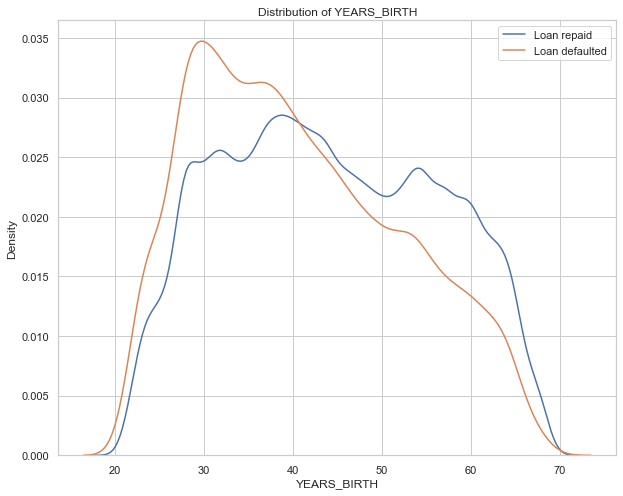

In [129]:
kde_plot(application, 'YEARS_BIRTH')

In [130]:
Ext_features = any_applications.columns[any_applications.columns.str.contains('EXT_')]

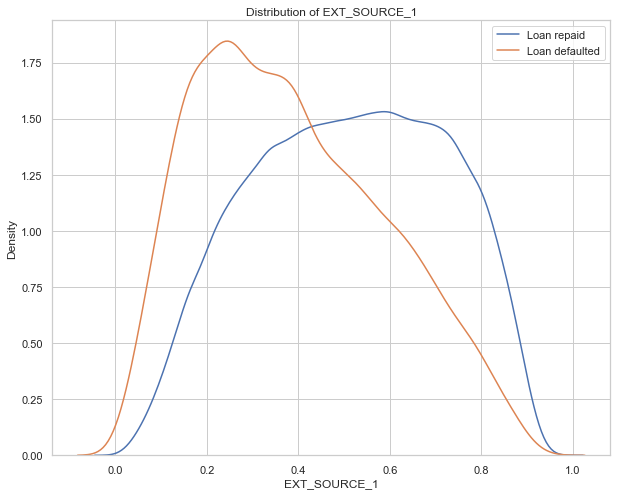

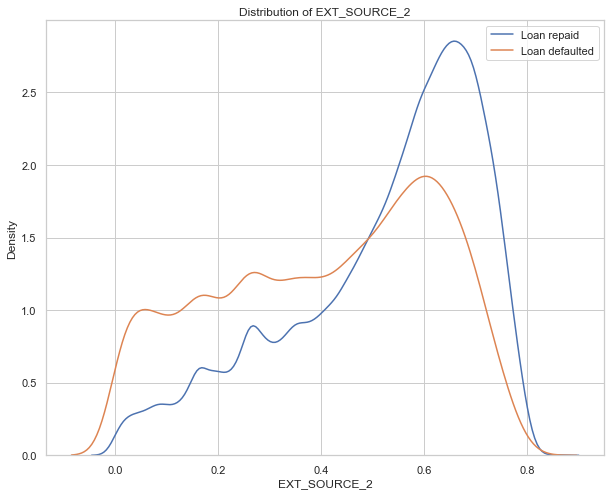

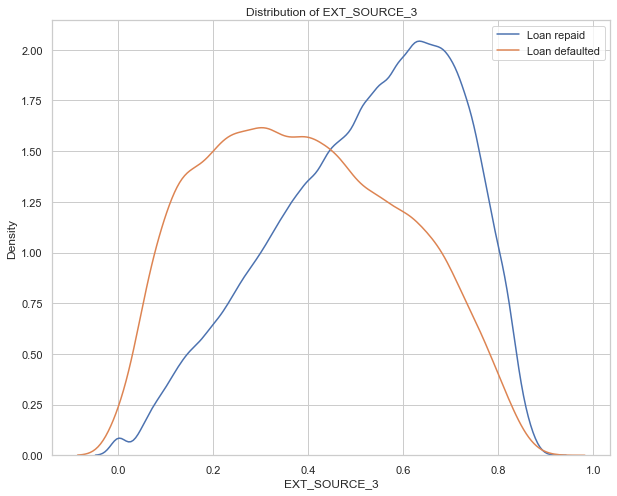

In [131]:
for i in Ext_features:
    kde_plot(application, i)

In [132]:
any_applications.drop(columns=Ext_features, inplace=True)

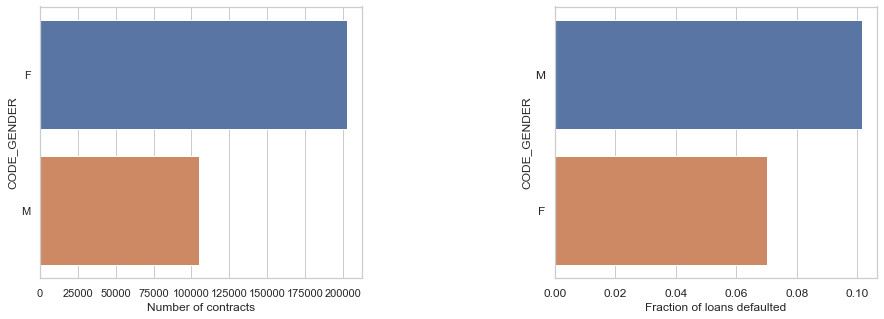

In [133]:
plot_bar_gen('CODE_GENDER', df=application)

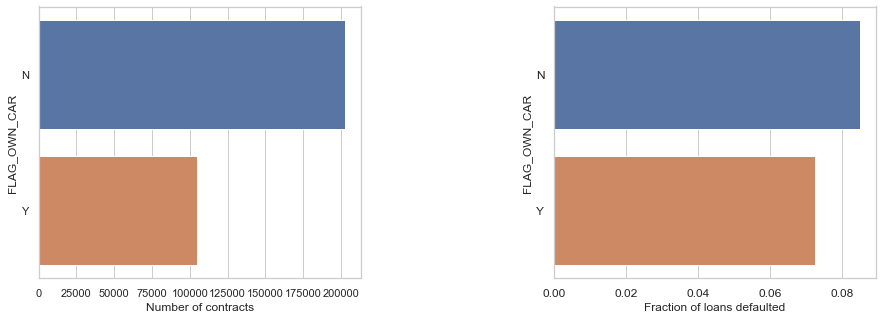

In [134]:
plot_bar_gen('FLAG_OWN_CAR', df=application)

In [135]:
application['OWN_CAR_AGE'].median()

9.0

In [136]:
application['OWN_CAR_AGE_LVL'] = pd.qcut(
    application['OWN_CAR_AGE'],
    3,
    labels=['RECENT_CAR',
            'AVG_AGE_CAR',
            'OLD_CAR'])

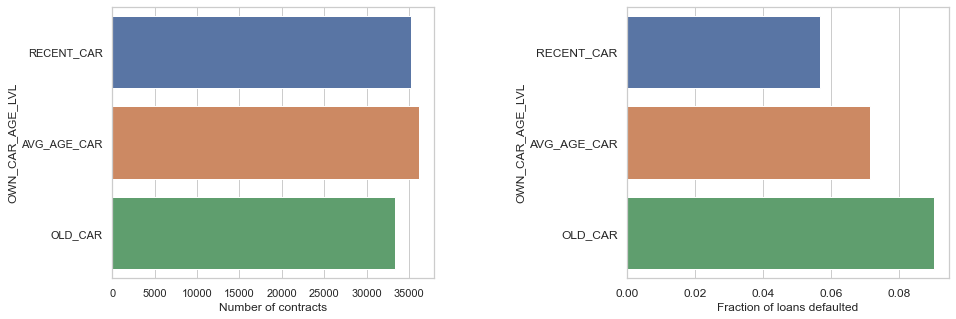

In [137]:
plot_bar_gen('OWN_CAR_AGE_LVL', df=application)

In [138]:
application['CNT_CHILDREN']
# bin child number
bins = [0, 5, np.inf]
values = ['0', '1']
application['CNT_CHILDREN_LVL'] = pd.cut(application['CNT_CHILDREN'], bins, labels=values)

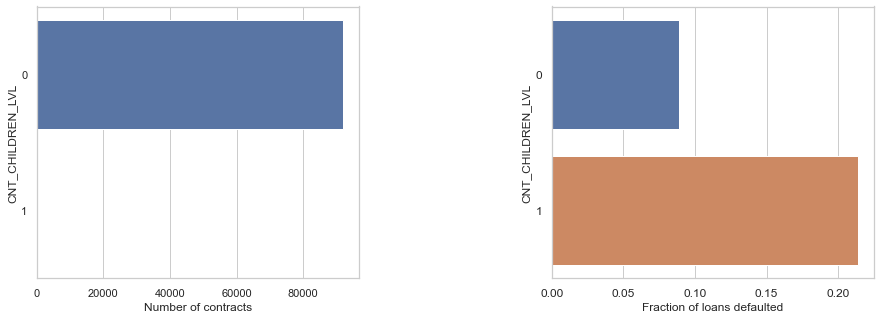

In [139]:
plot_bar_gen('CNT_CHILDREN_LVL', df=application)

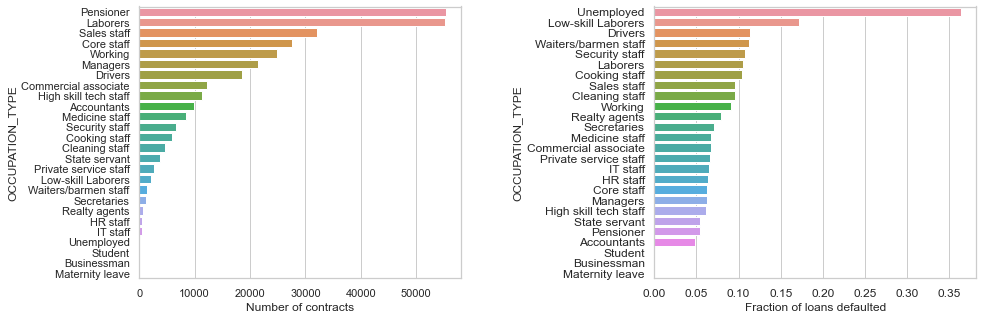

In [140]:
plot_bar_gen('OCCUPATION_TYPE', df=application)

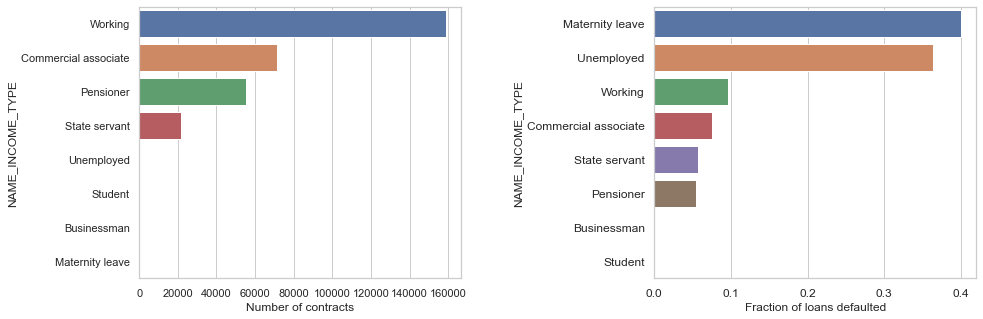

In [141]:
plot_bar_gen('NAME_INCOME_TYPE', df=application)

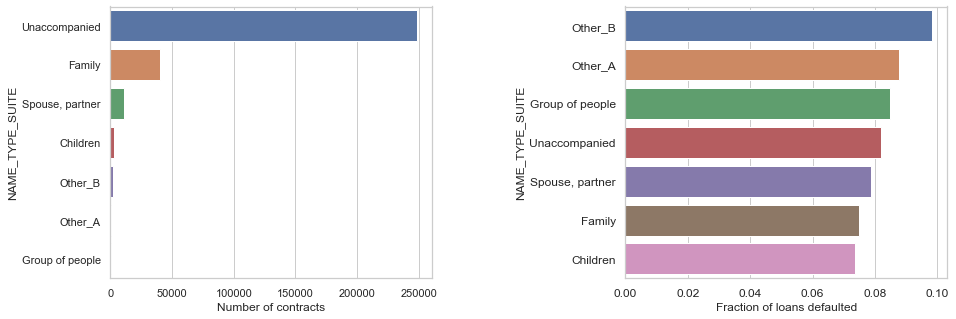

In [142]:
plot_bar_gen('NAME_TYPE_SUITE', df=application)

# Missing values

In [143]:
any_applications['AMT_REQ_CREDIT_BUREAU_HOUR'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_DAY'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_WEEK'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_MON'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_QRT'].fillna(0, inplace=True)
any_applications['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(0, inplace=True)


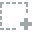
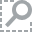
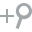
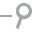
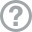
...
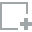
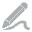
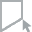
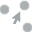
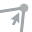

In [144]:
plot_missing(any_applications)

In [145]:
previous.drop(
    columns=['RATE_INTEREST_PRIMARY',
             'RATE_INTEREST_PRIVILEGED',
             'FLAG_LAST_APPL_PER_CONTRACT',
             'NFLAG_LAST_APPL_IN_DAY'],
    inplace=True)


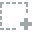
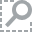
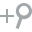
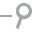
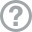
...
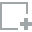
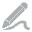
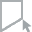
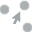
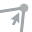

In [146]:
plot_missing(previous)

## Lean datasets

In [147]:
# save the lean datasets
with open("Data/bureau.pkl", mode="wb") as df:
    pickle.dump(bureau, df)
with open("Data/previous.pkl", mode="wb") as df:
    pickle.dump(previous, df)
with open("Data/any_app.pkl", mode="wb") as df:
    pickle.dump(any_applications, df)

In [148]:
bureau.head(1)

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Cash loans,-131,NaN


In [149]:
previous.head(1)

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,RATE_DOWN_PAYMENT,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,N_CREDIT_TYPE,N_FLAG_REJECTED,N_CODE_REJECT_REASON,N_CONTRACT_STATUS
0,2030495,271877,Consumer loans,1730.43,17145.0,17145.0,0.0,17145.0,SATURDAY,15,0.0,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0,Cash loans,0,REJECTED_XAP,APPROVED


In [150]:
any_applications.head(1)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,...,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_APPROVED,N_CNT_PREV_NOTUSED,N_CNT_PREV_REJECTED_CLIENT,N_CNT_PREV_REJECTED_HC,N_CNT_PREV_REJECTED_LIMIT,N_CNT_PREV_REJECTED_SCO,N_CNT_PREV_REJECTED_SCOFR,N_CNT_PREV_REJECTED_SYSTEM,N_CNT_PREV_REJECTED_VERIF,N_CNT_PREV_REJECTED_XNA,N_FLAG_REJECTED,N_ADJ_REJECT_RECENCY_INDEX,N_PREV_LAST_DECISION,N_PREV_LAST_APPLICATION,N_CNT_PREV_LOANS,N_REJECT_RATE,N_CNT_BUR_LOANS,N_BUR_LAST_APPLICATION,N_CNT_TOT_LOANS,YEARS_BIRTH,N_DAYS_EMPLOYED_RATIO,N_CREDIT_INCOME_RATIO,N_INCOME_PER_PERSON,N_ANNUITY_INCOME_RATIO,N_CREDIT_TERM
0,100002,1.0,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-637.0,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.0247,0.0369,0.9722,0.6192,0.0143,0.0,0.069,0.0833,0.125,0.0369,0.0202,0.019,0.0,0.0,0.0252,0.0383,0.9722,0.6341,0.0144,0.0,0.069,...,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,APPROVED,-606.0,1.0,0.0,8.0,-103.0,9.0,25.920548,0.067329,2.007889,202500.0,0.121978,0.060749


## Experiment response encoding

In [156]:
def response_fit(data, column):
    '''
    Response Encoding Fit Function
    Function to create a vocabulary with the probability of occurrence of each category for categorical features
    for a given class label.

    Inputs:
        data: DataFrame
            training Dataset
        column: str
            the categorical column for which vocab is to be generated

    Returns:
        Dictionary of probability of occurrence of each category in a particular class label.
    '''

    dict_occurrences = {1: {}, 0: {}}
    for label in [0,1]:
        dict_occurrences[label] = dict((data[column][data.TARGET == label].value_counts() / data[column].value_counts()).fillna(0))

    return dict_occurrences

def response_transform(data, column, dict_mapping):
    '''
    Response Encoding Transform Function
    Function to transform the categorical feature into two features, which contain the probability
    of occurrence of that category for each class label.

    Inputs:
        data: DataFrame
            DataFrame whose categorical features are to be encoded
        column: str
            categorical column whose encoding is to be done
        dict_mapping: dict
            Dictionary obtained from Response Fit function for that particular column

    Returns:
        None
    '''

    data[column + '_0'] = data[column].map(dict_mapping[0])
    data[column + '_1'] = data[column].map(dict_mapping[1])

In [158]:
# using response coding on categorical features, to keep the dimensionality in check
# categorical columns to perform response coding on
categorical_columns_application = application.dtypes[application.dtypes == 'object'].index.tolist()
for col in categorical_columns_application:
    # extracting the dictionary with values corresponding to TARGET variable 0 and 1 for each of the categories
    mapping_dictionary = response_fit(application, col)
    #saving the mapping dictionary to pickle file
    # with open(f'Response_coding_dict_{col}.pkl', 'wb') as f:
    #    pickle.dump(mapping_dictionary, f)
    # mapping this dictionary with our DataFrame
    response_transform(any_applications, col, mapping_dictionary)
    # removing the original categorical columns
    _ = any_applications.pop(col)

In [159]:
any_applications.head(3)

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,...,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,N_CNT_PREV_APPROVED,N_CNT_PREV_NOTUSED,N_CNT_PREV_REJECTED_CLIENT,N_CNT_PREV_REJECTED_HC,N_CNT_PREV_REJECTED_LIMIT,N_CNT_PREV_REJECTED_SCO,N_CNT_PREV_REJECTED_SCOFR,N_CNT_PREV_REJECTED_SYSTEM,N_CNT_PREV_REJECTED_VERIF,N_CNT_PREV_REJECTED_XNA,N_FLAG_REJECTED,N_ADJ_REJECT_RECENCY_INDEX,N_PREV_LAST_DECISION,N_PREV_LAST_APPLICATION,N_CNT_PREV_LOANS,N_REJECT_RATE,N_CNT_BUR_LOANS,N_BUR_LAST_APPLICATION,N_CNT_TOT_LOANS,YEARS_BIRTH,N_DAYS_EMPLOYED_RATIO,N_CREDIT_INCOME_RATIO,N_INCOME_PER_PERSON,N_ANNUITY_INCOME_RATIO,N_CREDIT_TERM,NAME_CONTRACT_TYPE_0,NAME_CONTRACT_TYPE_1,CODE_GENDER_0,CODE_GENDER_1,FLAG_OWN_CAR_0,FLAG_OWN_CAR_1,FLAG_OWN_REALTY_0,FLAG_OWN_REALTY_1,NAME_TYPE_SUITE_0,NAME_TYPE_SUITE_1,NAME_INCOME_TYPE_0,NAME_INCOME_TYPE_1,NAME_EDUCATION_TYPE_0,NAME_EDUCATION_TYPE_1,NAME_FAMILY_STATUS_0,NAME_FAMILY_STATUS_1,NAME_HOUSING_TYPE_0,NAME_HOUSING_TYPE_1,OCCUPATION_TYPE_0,OCCUPATION_TYPE_1,WEEKDAY_APPR_PROCESS_START_0,WEEKDAY_APPR_PROCESS_START_1,ORGANIZATION_TYPE_0,ORGANIZATION_TYPE_1,FONDKAPREMONT_MODE_0,FONDKAPREMONT_MODE_1,HOUSETYPE_MODE_0,HOUSETYPE_MODE_1,WALLSMATERIAL_MODE_0,WALLSMATERIAL_MODE_1,EMERGENCYSTATE_MODE_0,EMERGENCYSTATE_MODE_1
0,100002,1.0,0,202500.0,406597.5,24700.5,351000.0,0.018801,-637.0,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,10,0,0,0,0,0,0,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,...,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,APPROVED,-606.0,1.0,0.0,8.0,-103.0,9.0,25.920548,0.067329,2.007889,202500.0,0.121978,0.060749,0.916541,0.083459,0.898581,0.101419,0.914997,0.085003,0.920383,0.079617,0.918169,0.081831,0.904113,0.095887,0.910600,0.089400,0.901923,0.098077,0.922042,0.077958,0.894212,0.105788,0.918396,0.081604,0.907004,0.092996,0.930217,0.069783,0.930565,0.069435,0.925941,0.074059,0.93035,0.06965
1,100003,0.0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-1188.0,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,11,0,0,0,0,0,0,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.079,0.0554,0.0,0.0,0.0968,0.0529,0.9851,0.7987,0.0608,...,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,APPROVED,-746.0,3.0,0.0,4.0,-606.0,7.0,45.931507,0.070862,4.790750,135000.0,0.132217,0.027598,0.916541,0.083459,0.930007,0.069993,0.914997,0.085003,0.916751,0.083249,0.925052,0.074948,0.942450,0.057550,0.946448,0.053552,0.924400,0.075600,0.922042,0.077958,0.936958,0.063042,0.922428,0.077572,0.940852,0.059148,0.930217,0.069783,0.930565,0.069435,0.929753,0.070247,0.93035,0.06965
2,100004,0.0,0,67500.0,135000.0,6750.0,135000.0,0.010032,-225.0,-4